# Extract, transform, and load (ETL)

In [1]:
# Dependencies
import numpy as np
import pandas as pd
from pathlib import Path
import csv
import scipy.stats as st
import matplotlib.pyplot as plt
import matplotlib as mpl
import geopandas as gpd
from shapely.geometry import Point
import json
import geoplot
from shapely.geometry import Point, Polygon
from shapely.geometry import Point, MultiPolygon
import shapefile as shp
import geojson as gjs
%matplotlib inline
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.cm as cm
from geopy.distance import distance
import pydeck as pdk
from geopy.distance import geodesic
import matplotlib.cm as cm
from matplotlib.colorbar import make_axes
import os
import sqlite3



In [2]:
# Make a reference to the shooting_incident_data.csv file path
csv_path = Path('../Resources/shooting_incident_data.csv')

In [3]:
# Import the csv file as a DataFrame
ny_crime_df = pd.read_csv('../Resources/shooting_incident_data.csv')
ny_crime_df.head()

,incident_key,occur_date,occur_time,boro,precinct,jurisdiction_code,location_desc,statistical_murder_flag,perp_age_group,perp_sex,...,vic_age_group,vic_sex,vic_race,x_coord_cd,y_coord_cd,latitude,longitude,geocoded_column,loc_classfctn_desc,loc_of_occur_desc
0,216351812,2020-08-07T00:00:00.000,14:40:00,BRONX,48,0.0,NaN,False,18-24,M,...,25-44,M,BLACK HISPANIC,1013656.750,251677.296875,40.857430,-73.893696,POINT (-73.89369634299999 40.857430143000045),NaN,NaN
1,11118232,2006-04-26T00:00:00.000,18:26:00,QUEENS,105,0.0,PVT HOUSE,True,45-64,M,...,25-44,M,BLACK,1055658.875,201767.437500,40.720202,-73.742390,POINT (-73.74239028299996 40.72020175200004),NaN,NaN
2,26543083,2007-01-28T00:00:00.000,06:00:00,BROOKLYN,63,0.0,RESTAURANT/DINER,True,NaN,NaN,...,25-44,M,BLACK,1005491.625,170817.250000,40.635513,-73.923469,POINT (-73.92346854399995 40.63551320600004),NaN,NaN
3,228798150,2021-05-27T00:00:00.000,21:06:00,BRONX,43,2.0,MULTI DWELL - PUBLIC HOUS,False,NaN,NaN,...,25-44,M,BLACK,1026600.000,238546.000000,40.821336,-73.846990,POINT (-73.84698961699996 40.821336002000066),NaN,NaN
4,93607540,2013-11-15T00:00:00.000,22:37:00,BRONX,47,0.0,NaN,False,NaN,NaN,...,18-24,M,BLACK,1027500.375,260415.968750,40.881358,-73.843595,POINT (-73.84359545999996 40.88135813300005),NaN,NaN


In [4]:
# Captilize the columns using list comprehension
ny_crime_df.columns = [column_name.upper() for column_name in ny_crime_df.columns.tolist()]
ny_crime_df.tail()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,JURISDICTION_CODE,LOCATION_DESC,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,...,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,LATITUDE,LONGITUDE,GEOCODED_COLUMN,LOC_CLASSFCTN_DESC,LOC_OF_OCCUR_DESC
27307,243767115,2022-04-16T00:00:00.000,22:15:00,QUEENS,109,0.0,MULTI DWELL - APT BUILD,False,25-44,M,...,25-44,M,ASIAN / PACIFIC ISLANDER,1030410.0,217889.0,40.764613,-73.833362,POINT (-73.833362 40.764613),NaN,NaN
27308,242393701,2022-03-20T00:00:00.000,02:50:00,BRONX,40,2.0,MULTI DWELL - PUBLIC HOUS,False,(null),(null),...,18-24,M,WHITE HISPANIC,1006807.0,238604.0,40.821562,-73.918498,POINT (-73.918498 40.821562),NaN,NaN
27309,244279288,2022-04-27T00:00:00.000,15:20:00,BROOKLYN,75,0.0,(null),False,<18,M,...,18-24,M,BLACK HISPANIC,1018053.0,189125.0,40.685718,-73.878116,POINT (-73.878116 40.685718),NaN,NaN
27310,250752756,2022-09-07T00:00:00.000,19:05:00,BROOKLYN,75,0.0,(null),True,18-24,M,...,25-44,M,BLACK,1017276.0,184413.0,40.672789,-73.880940,POINT (-73.88094 40.672789),NaN,NaN
27311,250044143,2022-08-23T00:00:00.000,16:19:00,BRONX,48,0.0,(null),False,18-24,M,...,65+,F,BLACK,1016031.0,249136.0,40.850440,-73.885123,POINT (-73.885123 40.85044),NaN,NaN


In [5]:
# Get the datatype with column names.
ny_crime_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27312 entries, 0 to 27311
Data columns (total 21 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   INCIDENT_KEY             27312 non-null  int64  
 1   OCCUR_DATE               27312 non-null  object 
 2   OCCUR_TIME               27312 non-null  object 
 3   BORO                     27312 non-null  object 
 4   PRECINCT                 27312 non-null  int64  
 5   JURISDICTION_CODE        27310 non-null  float64
 6   LOCATION_DESC            12335 non-null  object 
 7   STATISTICAL_MURDER_FLAG  27312 non-null  bool   
 8   PERP_AGE_GROUP           17968 non-null  object 
 9   PERP_SEX                 18002 non-null  object 
 10  PERP_RACE                18002 non-null  object 
 11  VIC_AGE_GROUP            27312 non-null  object 
 12  VIC_SEX                  27312 non-null  object 
 13  VIC_RACE                 27312 non-null  object 
 14  X_COORD_CD            

In [6]:
# Convert OCCUR_DATE to the appropriate format
ny_crime_df['OCCUR_DATE'] = pd.to_datetime(ny_crime_df['OCCUR_DATE'])

In [7]:
# Replace and fill na values with UNKNOWN
ny_crime_df['PERP_AGE_GROUP'] = ny_crime_df['PERP_AGE_GROUP'].replace('(null)', 'UNKNOWN')
ny_crime_df['PERP_AGE_GROUP'] = ny_crime_df['PERP_AGE_GROUP'].fillna('UNKNOWN')

# Replace '1020' to UNKNOWN for PERP_AGE_GROUP
ny_crime_df['PERP_AGE_GROUP'] = ny_crime_df['PERP_AGE_GROUP'].replace('1020', 'UNKNOWN')

In [8]:
# Replace and fill na values with UNKNOWN
ny_crime_df['PERP_SEX'] = ny_crime_df['PERP_SEX'].replace('(null)', 'U')
ny_crime_df['PERP_SEX'] = ny_crime_df['PERP_SEX'].fillna('U')

In [9]:
# Replace and fill na values with UNKNOWN
ny_crime_df['PERP_RACE'] = ny_crime_df['PERP_RACE'].replace('(null)', 'UNKNOWN')
ny_crime_df['PERP_RACE'] = ny_crime_df['PERP_RACE'].fillna('UNKNOWN')

In [10]:
# Replace '1022' to UNKNOWN for VIC_AGE_GROUP
ny_crime_df['VIC_AGE_GROUP'] = ny_crime_df['VIC_AGE_GROUP'].replace('1022', 'UNKNOWN')

In [11]:
# Drop rows with LATITUDE or LONGITUDE as null or invalid values
ny_crime_df = ny_crime_df.dropna(subset=['LONGITUDE'])

In [12]:
# Drop columns not needed filled with a lot of NA
ny_crime_df = ny_crime_df.drop(columns=['JURISDICTION_CODE', 'LOCATION_DESC', 'LOC_CLASSFCTN_DESC', 'LOC_OF_OCCUR_DESC', 'GEOCODED_COLUMN'])
ny_crime_df.head()

,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,LATITUDE,LONGITUDE
0,216351812,2020-08-07,14:40:00,BRONX,48,False,18-24,M,BLACK,25-44,M,BLACK HISPANIC,1013656.750,251677.296875,40.857430,-73.893696
1,11118232,2006-04-26,18:26:00,QUEENS,105,True,45-64,M,BLACK,25-44,M,BLACK,1055658.875,201767.437500,40.720202,-73.742390
2,26543083,2007-01-28,06:00:00,BROOKLYN,63,True,UNKNOWN,U,UNKNOWN,25-44,M,BLACK,1005491.625,170817.250000,40.635513,-73.923469
3,228798150,2021-05-27,21:06:00,BRONX,43,False,UNKNOWN,U,UNKNOWN,25-44,M,BLACK,1026600.000,238546.000000,40.821336,-73.846990
4,93607540,2013-11-15,22:37:00,BRONX,47,False,UNKNOWN,U,UNKNOWN,18-24,M,BLACK,1027500.375,260415.968750,40.881358,-73.843595


# Data Housing 

In [13]:
# House the DataFrame in SQLite
import sqlite3
connection = sqlite3.connect('../Resources/NYC Shooting Incidents - Clean.sqlite')
ny_crime_df.to_sql('new_york_shooting_incidents', connection, if_exists='replace', index=False)
connection.close()


In [14]:
# Saving the clean csv file into the Resource folder
ny_crime_df.to_csv("../Resources/NYC Shooting Incidents - Clean.csv", index=False)

In [15]:
# converting the csv file into geojson.
def make_geo_point(row):
    return Point(row['LONGITUDE'], row['LATITUDE'])

ny_crime_df['GEOCODE_POINT'] = ny_crime_df.apply(make_geo_point, axis=1)

gdf = gpd.GeoDataFrame(ny_crime_df, geometry='GEOCODE_POINT')

In [16]:
# Get the datatype with column names and confirm the geocode_point colum is geometry.
gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 27302 entries, 0 to 27311
Data columns (total 17 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   INCIDENT_KEY             27302 non-null  int64         
 1   OCCUR_DATE               27302 non-null  datetime64[ns]
 2   OCCUR_TIME               27302 non-null  object        
 3   BORO                     27302 non-null  object        
 4   PRECINCT                 27302 non-null  int64         
 5   STATISTICAL_MURDER_FLAG  27302 non-null  bool          
 6   PERP_AGE_GROUP           27302 non-null  object        
 7   PERP_SEX                 27302 non-null  object        
 8   PERP_RACE                27302 non-null  object        
 9   VIC_AGE_GROUP            27302 non-null  object        
 10  VIC_SEX                  27302 non-null  object        
 11  VIC_RACE                 27302 non-null  object        
 12  X_COORD_CD               2730

In [17]:
# Convert datetime columns to string in ISO format
gdf['OCCUR_DATE'] = gdf['OCCUR_DATE'].dt.strftime('%Y-%m-%dT%H:%M:%S')

# Convert the GeoDataFrame to JSON
json_string = gdf.to_json()

In [18]:
# Saving the Json file into the Resource folder
with open('../Resources/NYC Shooting Incidents - JSON.json', 'w') as f:
    f.write(json_string)

# Data Analysis

In [19]:
# Import the json file as a DataFrame
ny_crime_gpd = gpd.read_file("../Resources/NYC Shooting Incidents - JSON.json")
ny_crime_gpd.head()

,id,INCIDENT_KEY,OCCUR_DATE,OCCUR_TIME,BORO,PRECINCT,STATISTICAL_MURDER_FLAG,PERP_AGE_GROUP,PERP_SEX,PERP_RACE,VIC_AGE_GROUP,VIC_SEX,VIC_RACE,X_COORD_CD,Y_COORD_CD,LATITUDE,LONGITUDE,geometry
0,0,216351812,2020-08-07,14:40:00,BRONX,48,False,18-24,M,BLACK,25-44,M,BLACK HISPANIC,1013656.750,251677.296875,40.857430,-73.893696,POINT (-73.89370 40.85743)
1,1,11118232,2006-04-26,18:26:00,QUEENS,105,True,45-64,M,BLACK,25-44,M,BLACK,1055658.875,201767.437500,40.720202,-73.742390,POINT (-73.74239 40.72020)
2,2,26543083,2007-01-28,06:00:00,BROOKLYN,63,True,UNKNOWN,U,UNKNOWN,25-44,M,BLACK,1005491.625,170817.250000,40.635513,-73.923469,POINT (-73.92347 40.63551)
3,3,228798150,2021-05-27,21:06:00,BRONX,43,False,UNKNOWN,U,UNKNOWN,25-44,M,BLACK,1026600.000,238546.000000,40.821336,-73.846990,POINT (-73.84699 40.82134)
4,4,93607540,2013-11-15,22:37:00,BRONX,47,False,UNKNOWN,U,UNKNOWN,18-24,M,BLACK,1027500.375,260415.968750,40.881358,-73.843595,POINT (-73.84360 40.88136)


In [20]:
# Confirm the data type of the DataFrame
ny_crime_gpd.shape, type(ny_crime_gpd)

((27302, 18), geopandas.geodataframe.GeoDataFrame)

In [21]:
# Define shooting incident layer to build scatter plot
layer = pdk.Layer(
    "ScatterplotLayer",
    data = ny_crime_gpd,
    get_position=["LONGITUDE", "LATITUDE"],
    get_color = [255, 0, 0, 140],
    get_radius = 100,
    pickable=True,
)
# Set up the map view
view_state = pdk.ViewState(
        longitude=-74.0060,
        latitude=40.7128,
        zoom=10,
        pitch=50,)
# Create the pydeck Deck object
deck = pdk.Deck(
    layers=[layer],
    initial_view_state=view_state,
    tooltip={"text": "{Description}"},
             )
# Render the map
deck.to_html("../html/ny_incidents_map.html", notebook_display=True)

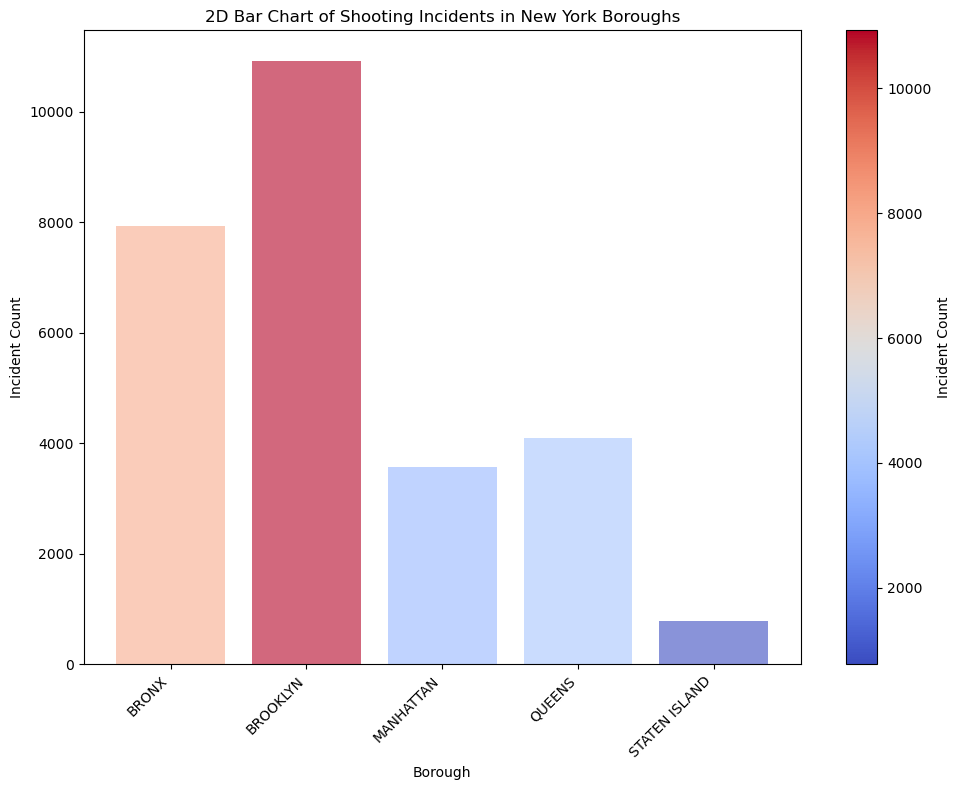

In [22]:
# count the number of incidence for each Boroughs.
borough_counts = ny_crime_df['BORO'].value_counts().reset_index()
borough_counts.columns = ['BORO', 'Incident Count']

# Sort by borough for consistent plotting
borough_counts = borough_counts.sort_values(by='BORO')

# Extract data for plotting
boroughs = borough_counts['BORO']
incident_counts = borough_counts['Incident Count']

# Normalize the incident counts for color mapping
norm = plt.Normalize(incident_counts.min(), incident_counts.max())
colors = cm.coolwarm(norm(incident_counts))

# Plotting the 2D bar chart
fig, ax = plt.subplots(figsize=(10, 8))

# Generate the x positions
x = np.arange(len(boroughs))

# Create the 2D bar chart with colored bars
bars = ax.bar(x, incident_counts, color=colors, alpha=0.6)

# Add labels and title
ax.set_xticks(x)
ax.set_xticklabels(boroughs, rotation=45, ha='right')
ax.set_xlabel('Borough')
ax.set_ylabel('Incident Count')
ax.set_title('2D Bar Chart of Shooting Incidents in New York Boroughs')

# Add a color bar for the incident counts
sm = plt.cm.ScalarMappable(cmap=cm.coolwarm, norm=norm)
sm.set_array([])
cbar = plt.colorbar(sm, ax=ax)
cbar.set_label('Incident Count')

plt.tight_layout()
plt.show()

In [ ]:
# Load school district (landmark) data
ny_crime_df = pd.read_csv("../Resources/NYC Shooting Incidents - Clean.csv")
landmark_facilities_gpd = gpd.read_file("../Resources/School Districts.geojson")
landmark_facilities_gpd = landmark_facilities_gpd.to_crs('EPSG:4326')

# Load NYC shooting incidents data
ny_crime_gpd = gpd.read_file("../Resources/NYC Shooting Incidents - JSON.json")
ny_crime_gpd = ny_crime_gpd.to_crs('EPSG:4326')

# Function to get the centroid of a MultiPolygon or use the point geometry directly

def get_centroid(geom):
    if isinstance(geom, MultiPolygon):
        return geom.centroid
    return geom

# Function to calculate the nearest landmark distances

def calculate_nearest_landmark_distances(crime_gdf, landmarks_gdf):
    distances = []
    for crime in crime_gdf.itertuples():
        crime_point = crime.geometry
        min_distance = float('inf')
        for landmark in landmarks_gdf.itertuples():
            landmark_point = get_centroid(landmark.geometry)
            dist = geodesic((crime_point.y, crime_point.x), (landmark_point.y, landmark_point.x)).meters
            if dist < min_distance:
                min_distance = dist
        distances.append(min_distance)
    return distances

# Calculate nearest landmark distances
ny_crime_gpd['nearest_landmark_distance'] = calculate_nearest_landmark_distances(ny_crime_gpd, landmark_facilities_gpd)

# Prepare pydeck data
ny_crime_df = ny_crime_gpd.drop(columns='geometry')
landmark_facilities_df = landmark_facilities_gpd.drop(columns='geometry')

# Define shootings layer
shooting_layer = pdk.Layer(
    "ScatterplotLayer",
    data=ny_crime_df,
    get_position= ["LONGITUDE", "LATITUDE"], 
    get_fill_color=[255, 100, 100, 140],
    get_radius=100,
    pickable=True,
    tooltip={"text": "Shooting Incident"}
)

# Define landmarks layer (school districts)
landmark_layer = pdk.Layer(
    "ScatterplotLayer",
    data=landmark_facilities_df,
    get_position=["LONGITUDE", "LATITUDE"],
    get_fill_color=[200, 0, 180, 140],
    get_radius=200,
    pickable=True,
    tooltip={"text": "Landmark: {name}"}
)

# Set up the map view

view_state = pdk.ViewState(
    longitude=-74.0060,
    latitude=40.7128,
    zoom=10,
    pitch=50,
)

# Create the pydeck Deck object
deck = pdk.Deck(
    layers=[shooting_layer, landmark_layer],
    initial_view_state=view_state,
)

# Render the map
deck.to_html("../html/ny_shootings_landmarks_map.html", notebook_display=True)

In [ ]:
# Load NYC shooting incidents data
ny_crime_gpd = ny_crime_gpd.to_crs('EPSG:4326')

# Convert the Occur_date column to datetime.
ny_crime_gpd["OCCUR_DATE"] = pd.to_datetime(ny_crime_gpd["OCCUR_DATE"])

# Set Date column as the index (required for resampling)
ny_crime_gpd.set_index("OCCUR_DATE", inplace=True)

# Ensure the index is a DatetimeIndex
if not isinstance(ny_crime_gpd.index, pd.DatetimeIndex):
    ny_shooting_df.index = pd.to_datetime(ny_shooting_df.index)

# Aggregate by month
monthly_counts = ny_crime_gpd.resample('M').size()

# Prepare data for 3D plot
months = monthly_counts.index.month
years = monthly_counts.index.year
counts = monthly_counts.values

# Create a figure and a 3D axis
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(111, projection='3d')

# Plot 3D bars
ax.bar3d(years, months, 0, 0.8, 0.8, counts, color='b', edgecolor='k')

# Set labels and title
ax.set_xlabel('Year')
ax.set_ylabel('Month')
ax.set_zlabel('Number of Incidents')
ax.set_title('Monthly Shooting Incidents in NYC (3D Bar Chart)')

# Customize tick labels (optional)
ax.set_xticks(years.unique())
ax.set_xticklabels(years.unique(), rotation=45)
ax.set_yticks(range(1, 13))
ax.set_yticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])

# Show plot
plt.show()

In [ ]:
ny_crime_gpd.head(2)

In [ ]:
# Resampling)
daily_counts = ny_crime_gpd.resample("D").size()

# Monthly trends
monthly_counts = ny_crime_gpd.resample("M").size()

# Yearly trends
yearly_counts = ny_crime_gpd.resample("Y").size()

# Daily trends plot
plt.figure(figsize=(12,6))
daily_counts.plot(title="Daily shooting Incidents", xlabel="Year", ylabel="Number of incidents")
plt.grid(True)
plt.show()

In [ ]:
# Monthly trends plot
plt.figure(figsize=(12,6))
monthly_counts.plot(title="Monthly shooting Incidents", xlabel="Month", ylabel="Number of incidents")
plt.grid(True)
plt.xticks(rotation=45)
plt.show()


In [ ]:
# Yearly trends plot
plt.figure(figsize=(12,6))
yearly_counts.plot(title="Yearly shooting Incidents", xlabel="year", ylabel="Number of incidents")
plt.grid(True)
plt.xticks(rotation=45)
plt.show()